In [0]:
%pip install tqdm

Python interpreter will be restarted.
Python interpreter will be restarted.


In [0]:
# Load the CSV from DBFS (FileStore)
file_path = "/FileStore/simulated_ev_maintenance_dataset.csv"

df = spark.read.option("header", "true").option("inferSchema", "true").csv(file_path)

# Show schema and sample data
df = df.drop('frequent_maint')
df = df.drop('Days to Next Maintenance')
df.printSchema()
df.display(5)


root
 |-- Station ID: string (nullable = true)
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)
 |-- Address: string (nullable = true)
 |-- Charger Type: string (nullable = true)
 |-- Cost (USD/kWh): double (nullable = true)
 |-- Availability: string (nullable = true)
 |-- Distance to City (km): double (nullable = true)
 |-- Usage Stats (avg users/day): integer (nullable = true)
 |-- Station Operator: string (nullable = true)
 |-- Charging Capacity (kW): integer (nullable = true)
 |-- Connector Types: string (nullable = true)
 |-- Installation Year: integer (nullable = true)
 |-- Renewable Energy Source: string (nullable = true)
 |-- Reviews (Rating): double (nullable = true)
 |-- Parking Spots: integer (nullable = true)
 |-- Maintenance Frequency: string (nullable = true)
 |-- Station Age (yrs): integer (nullable = true)
 |-- Days Since Last Maintenance: integer (nullable = true)
 |-- is_dc_fast: integer (nullable = true)
 |-- has_multiple_connectors: i

Station ID,Latitude,Longitude,Address,Charger Type,Cost (USD/kWh),Availability,Distance to City (km),Usage Stats (avg users/day),Station Operator,Charging Capacity (kW),Connector Types,Installation Year,Renewable Energy Source,Reviews (Rating),Parking Spots,Maintenance Frequency,Station Age (yrs),Days Since Last Maintenance,is_dc_fast,has_multiple_connectors,capacity_level,usage_intensity,parking_spot_density,station_age,age_bucket,available_24_7,uses_renewables
EVS00001,-33.400998,77.974972,"4826 Random Rd, City 98, Country",AC Level 2,0.27,9:00-18:00,4.95,35,EVgo,350,"CCS, CHAdeMO",2013,Yes,4.0,7,Annually,12,107,0,1,High,0.1,5.0,12,Old,0,1
EVS00002,37.861857,-122.490299,"8970 San Francisco Ave, San Francisco",DC Fast Charger,0.19,24/7,4.96,83,EVgo,350,"Tesla, Type 2",2010,Yes,3.9,2,Monthly,15,24,1,1,High,0.23714285714285716,41.5,15,Old,1,1
EVS00003,13.776092,100.412776,"5974 Bangkok Ave, Bangkok",AC Level 2,0.48,6:00-22:00,8.54,24,ChargePoint,50,"Type 2, CCS",2019,No,3.6,9,Annually,6,353,0,1,Low,0.48,2.6666666666666665,6,Mid,0,0
EVS00004,43.62825,-79.468935,"6995 Toronto Ave, Toronto",AC Level 1,0.41,9:00-18:00,13.28,70,Greenlots,350,Type 2,2010,Yes,4.2,7,Monthly,15,19,0,0,High,0.2,10.0,15,Old,0,1
EVS00005,19.119865,72.913368,"5704 Mumbai Ave, Mumbai",AC Level 2,0.11,9:00-18:00,9.76,19,EVgo,350,CCS,2015,Yes,3.7,6,Annually,10,111,0,0,High,0.054285714285714284,3.1666666666666665,10,Mid,0,1
EVS00006,-23.695008,-46.548187,"1545 São Paulo Ave, São Paulo",AC Level 2,0.22,6:00-22:00,2.02,39,Ionity,350,Tesla,2016,Yes,3.2,9,Quarterly,9,76,0,0,High,0.11142857142857143,4.333333333333333,9,Mid,0,1
EVS00007,55.762409,37.65583,"1390 Moscow Ave, Moscow",AC Level 1,0.4,24/7,2.68,89,ChargePoint,350,"Tesla, CCS",2011,Yes,4.0,4,Annually,14,193,0,1,High,0.2542857142857143,22.25,14,Old,1,1
EVS00008,13.715561,100.561468,"7684 Bangkok Ave, Bangkok",AC Level 2,0.26,24/7,3.63,72,Ionity,350,Tesla,2013,Yes,4.3,9,Annually,12,25,0,0,High,0.2057142857142857,8.0,12,Old,1,1
EVS00009,41.807653,-87.755349,"6203 Chicago Ave, Chicago",AC Level 2,0.49,9:00-18:00,6.68,68,Greenlots,350,CCS,2013,No,3.4,1,Monthly,12,11,0,0,High,0.19428571428571428,68.0,12,Old,0,0
EVS00010,39.968701,116.433865,"4339 Beijing Ave, Beijing",AC Level 2,0.37,9:00-18:00,19.13,82,Tesla,150,"CCS, Tesla",2023,No,4.4,5,Quarterly,2,87,0,1,Medium,0.5466666666666666,16.4,2,Young,0,0


In [0]:
from pyspark.sql.functions import col, length, size, split

df = df.withColumn("connector_count", size(split(col("Connector Types"), ",")))
df = df.withColumn("usage_intensity", col("Usage Stats (avg users/day)") / col("Charging Capacity (kW)")) \
       .withColumn("parking_spot_density", col("Usage Stats (avg users/day)") / col("Parking Spots")) \
       .withColumn("connector_density", col("Usage Stats (avg users/day)") / col("connector_count")) \
       .withColumn("age_per_kw", col("station_age") / col("Charging Capacity (kW)")) \
       .withColumn("gap_per_age", col("Days Since Last Maintenance") / col("station_age"))

In [0]:
from pyspark.sql.functions import split, size, element_at, col

# Split Address by comma, get last element (Country)
df = df.withColumn("City", element_at(split(col("Address"), ",\\s*"), -1))

# Filter out rows where City is "Country" (i.e., header or invalid row)
df = df.filter(col("City") != "Country")

# Show value counts for cities
df.groupBy("City").count().orderBy("count", ascending=False).show()


+-------------+-----+
|         City|count|
+-------------+-----+
|San Francisco|  324|
|  Mexico City|  321|
|      Beijing|  319|
|       Mumbai|  315|
|    Cape Town|  314|
|      Bangkok|  314|
|      Chicago|  308|
|        Seoul|  299|
|        Dubai|  296|
|       Sydney|  295|
|       Berlin|  292|
|  Los Angeles|  286|
|       Moscow|  281|
|    São Paulo|  279|
|      Toronto|  257|
+-------------+-----+



## Clustering

In [0]:
feature_cols = [
    "usage_intensity",
    "station_age",
    "Days Since Last Maintenance",
    "Charging Capacity (kW)",
    "available_24_7",
    "parking_spot_density",
    "connector_density",
    "age_per_kw",
    "gap_per_age",
]

In [0]:
from pyspark.ml.feature import VectorAssembler, StandardScaler

assembler = VectorAssembler(inputCols=feature_cols, outputCol="features_vec")
df_vec = assembler.transform(df)

scaler = StandardScaler(inputCol="features_vec", outputCol="scaled_features", withStd=True, withMean=True)
df_scaled = scaler.fit(df_vec).transform(df_vec)


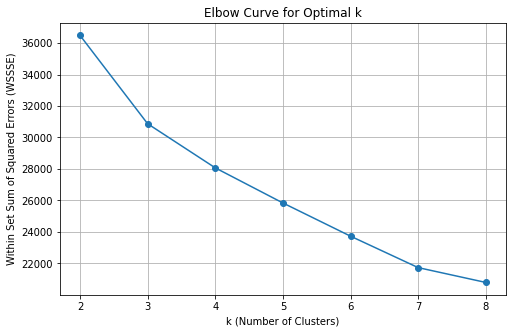

In [0]:
# -----------------------------------
# Elbow Curve to determine optimal k
# -----------------------------------
from pyspark.ml.clustering import KMeans
import matplotlib.pyplot as plt

cost = []
k_values = list(range(2, 9))

for k in k_values:
    kmeans = KMeans(featuresCol="scaled_features", k=k, seed=42)
    model = kmeans.fit(df_scaled)
    cost.append(model.summary.trainingCost)

plt.figure(figsize=(8, 5))
plt.plot(k_values, cost, marker='o')
plt.xlabel("k (Number of Clusters)")
plt.ylabel("Within Set Sum of Squared Errors (WSSSE)")
plt.title("Elbow Curve for Optimal k")
plt.grid(True)
plt.show()

In [0]:
# -----------------------------------
# Final Clustering with k = 3
# -----------------------------------
kmeans = KMeans(featuresCol="scaled_features", predictionCol="cluster", k=3, seed=42)
model = kmeans.fit(df_scaled)
df_clustered = model.transform(df_scaled)


In [0]:
# -----------------------------------
# Cluster Summary
# -----------------------------------
df_clustered.groupBy("cluster").avg(
    "usage_intensity", 
    "station_age", 
    "Days Since Last Maintenance", 
    "Charging Capacity (kW)", 
    "available_24_7",
    "parking_spot_density",
    "connector_density"
).orderBy("cluster").display()

cluster,avg(usage_intensity),avg(station_age),avg(Days Since Last Maintenance),avg(Charging Capacity (kW)),avg(available_24_7),avg(parking_spot_density),avg(connector_density)
0,2.2781477424850984,10.028112449799197,62.72222222222222,31.77777777777778,0.3139223560910308,19.237433596821177,48.99431057563588
1,0.848087873399076,6.713692946058091,268.655601659751,147.18948824343016,0.34439834024896265,16.945875321082774,41.029737206085755
2,0.4081071066913677,8.01904419690981,44.92490118577075,203.90441969098094,0.3460294646065397,14.357646624346216,38.29877829680201


In [0]:
from pyspark.sql.functions import when, col

df_final = df_clustered.withColumn(
    "risk_level",
    when(col("cluster") == 0, "High")
    .when(col("cluster") == 2, "Medium")
    .otherwise("Low")
)


In [0]:
display(
    df_final.groupBy("risk_level").count()
)


risk_level,count
High,1494
Low,723
Medium,2783


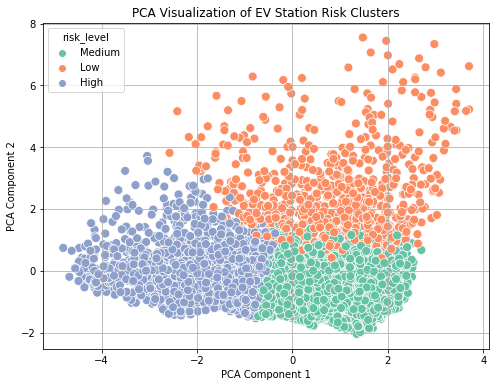

In [0]:
from pyspark.ml.feature import PCA
from pyspark.sql.functions import col

# Step 1: Run PCA on scaled features
pca = PCA(k=2, inputCol="scaled_features", outputCol="pca_features")
pca_model = pca.fit(df_scaled)
df_pca = pca_model.transform(df_scaled)

# Step 2: Join PCA output with cluster & risk_level info
df_with_pca = df_pca.join(
    df_final.select("Station ID", "cluster", "risk_level"),
    on="Station ID",
    how="inner"
)

# Step 3: Convert to Pandas for Seaborn plotting
df_pd = df_with_pca.select("pca_features", "cluster", "risk_level").rdd.map(
    lambda row: (
        float(row.pca_features[0]),
        float(row.pca_features[1]),
        row.cluster,
        row.risk_level
    )
).toDF(["x", "y", "cluster", "risk_level"]).toPandas()

# Step 4: Plot using seaborn
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.scatterplot(data=df_pd, x="x", y="y", hue="risk_level", palette="Set2", s=80)
plt.title("PCA Visualization of EV Station Risk Clusters")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.grid(True)
plt.show()


In [0]:
# Step 1: Get the component matrix (2 principal components × 7 features)
pca_components = pca_model.pc.toArray()  # shape: (2, 7)
pca_components

Out[28]: array([[-0.70608692,  0.0081795 ],
       [-0.02436469, -0.04040263],
       [-0.02103084, -0.50195277],
       [-0.01819729,  0.62122222],
       [ 0.7056449 , -0.00312602],
       [-0.01227744,  0.51139923],
       [ 0.04459526,  0.31446486]])

In [0]:
import pandas as pd

# Just confirm this matches your printout
pca_components = pca_model.pc.toArray()  # should be shape (7, 2)

# Feature list from your vector assembler
feature_cols = [
    "usage_intensity",              
    "station_age",                 
    "Days Since Last Maintenance", 
    "Parking Spots",               
    "Charging Capacity (kW)",      
    "has_multiple_connectors",     
    "available_24_7"
]

# Create DataFrame — no transpose!
component_df = pd.DataFrame(
    data=pca_components,
    index=feature_cols,
    columns=["PC1", "PC2"]
)

# Add absolute value columns for sorting
component_df["PC1_abs"] = component_df["PC1"].abs()
component_df["PC2_abs"] = component_df["PC2"].abs()

# Display sorted
print("🔹 Top features influencing PC1:")
display(component_df.sort_values("PC1_abs", ascending=False)[["PC1"]])

print("\n🔹 Top features influencing PC2:")
display(component_df.sort_values("PC2_abs", ascending=False)[["PC2"]])


🔹 Top features influencing PC1:


PC1
-0.7060869162385403
0.7056448955933661
0.04459525539138447
-0.024364692366242623
-0.021030842048127718
-0.01819728731312576
-0.012277435377253173



🔹 Top features influencing PC2:


PC2
0.6212222182519038
0.5113992316994327
-0.5019527693370787
0.3144648629834458
-0.040402629724292906
0.008179496388967929
-0.003126023230724353


## Predictive

In [0]:
import pandas as pd
import requests
from datetime import datetime, timedelta
from concurrent.futures import ThreadPoolExecutor, as_completed
from tqdm import tqdm

API_KEY = ""

# === Fetch Weather Function ===
def fetch_weather_threaded(lat, lon, days=30):
    end = int(datetime.utcnow().timestamp())
    start = int((datetime.utcnow() - timedelta(days=days)).timestamp())

    url = f"https://history.openweathermap.org/data/2.5/history/city?lat={lat}&lon={lon}&type=hour&start={start}&end={end}&units=metric&appid={API_KEY}"

    try:
        response = requests.get(url, timeout=10)
        data = response.json()
        if "list" not in data:
            return None

        records = []
        for entry in data["list"]:
            main = entry["main"]
            wind = entry["wind"]
            rain = entry.get("rain", {})
            records.append({
                "temp": main["temp"],
                "humidity": main["humidity"],
                "wind": wind["speed"],
                "rain": rain.get("1h", 0)
            })

        df = pd.DataFrame(records)

        temp_range = df["temp"].max() - df["temp"].min()
        avg_humidity = df["humidity"].mean()
        rain_hours = (df["rain"] > 0).sum()
        total_rain = df["rain"].sum()
        avg_wind = df["wind"].mean()

        score = (
            0.2 * (temp_range / 20) +
            0.2 * (avg_humidity / 100) +
            0.15 * (rain_hours / len(df)) +
            0.15 * min(total_rain / 30, 1) +
            0.1 * min(avg_wind / 10, 1)
        ) * 10

        scaled_score = round(1 + 9 * (min(score, 10) / 10), 1)

        return {
            "temp_range": round(temp_range, 2),
            "avg_humidity": round(avg_humidity, 2),
            "rain_hours": rain_hours,
            "total_rain": round(total_rain, 2),
            "avg_wind": round(avg_wind, 2),
            "weather_risk_score": scaled_score
        }

    except Exception as e:
        return None

# === Driver Function with Threading ===
def threaded_weather_enrichment(df_pandas, max_workers=30):
    results = []
    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        futures = {
            executor.submit(fetch_weather_threaded, row["Latitude"], row["Longitude"]): i
            for i, row in df_pandas.iterrows()
        }
        for future in tqdm(as_completed(futures), total=len(futures), desc="Enriching weather"):
            result = future.result()
            results.append(result)

    weather_df = pd.DataFrame(results)
    return pd.concat([df_pandas.reset_index(drop=True), weather_df], axis=1)

# === Apply in Databricks ===
# Step 1: Convert Spark DataFrame to Pandas
df_pandas = df.select("Station ID", "Latitude", "Longitude").toPandas()

# Step 2: Run enrichment
df_enriched = threaded_weather_enrichment(df_pandas)

# Step 3: Convert back to Spark if needed
df_enriched_spark = spark.createDataFrame(df_enriched)
df_enriched_spark.display()


Enriching weather:  47%|████▋     | 2114/4500 [00:

*** WARNING: max output size exceeded, skipping output. ***

Enriching weather: 100%|██████████| 4500/4500 [02:06<00:00, 35.60it/s]


Station ID,Latitude,Longitude,temp_range,avg_humidity,rain_hours,total_rain,avg_wind,weather_risk_score
EVS00002,37.861857,-122.490299,10.3,55.05,0,0.0,2.76,3.2
EVS00003,13.776092,100.412776,18.21,33.56,9,4.17,2.96,3.8
EVS00004,43.62825,-79.468935,15.71,68.01,14,8.55,2.33,4.3
EVS00005,19.119865,72.913368,25.68,71.83,4,5.17,4.46,5.3
EVS00006,-23.695008,-46.548187,15.71,68.01,14,8.55,2.33,4.3
EVS00007,55.762409,37.65583,15.71,68.01,14,8.55,2.33,4.3
EVS00008,13.715561,100.561468,13.88,71.16,11,13.84,6.06,4.8
EVS00009,41.807653,-87.755349,10.68,82.08,8,6.91,2.9,4.1
EVS00010,39.968701,116.433865,15.06,77.45,9,15.27,3.98,4.9
EVS00012,55.81937,37.543245,25.0,15.36,0,0.0,3.72,3.9


In [0]:
df_enriched_spark = df_enriched_spark.drop('Latitude', 'Longitude')

In [0]:
# Join with full Spark df (on Station ID)
df_final = df.join(df_enriched_spark, on="Station ID", how="left")
df_final.display()


Station ID,Latitude,Longitude,Address,Charger Type,Cost (USD/kWh),Availability,Distance to City (km),Usage Stats (avg users/day),Station Operator,Charging Capacity (kW),Connector Types,Installation Year,Renewable Energy Source,Reviews (Rating),Parking Spots,Maintenance Frequency,Station Age (yrs),Days Since Last Maintenance,is_dc_fast,has_multiple_connectors,capacity_level,usage_intensity,parking_spot_density,station_age,age_bucket,available_24_7,uses_renewables,connector_count,connector_density,age_per_kw,gap_per_age,City,temp_range,avg_humidity,rain_hours,total_rain,avg_wind,weather_risk_score
EVS00002,37.861857,-122.490299,"8970 San Francisco Ave, San Francisco",DC Fast Charger,0.19,24/7,4.96,83,EVgo,350,"Tesla, Type 2",2010,Yes,3.9,2,Monthly,15,24,1,1,High,0.23714285714285716,41.5,15,Old,1,1,2,41.5,0.04285714285714286,1.6,San Francisco,10.3,55.05,0,0.0,2.76,3.2
EVS00003,13.776092,100.412776,"5974 Bangkok Ave, Bangkok",AC Level 2,0.48,6:00-22:00,8.54,24,ChargePoint,50,"Type 2, CCS",2019,No,3.6,9,Annually,6,353,0,1,Low,0.48,2.6666666666666665,6,Mid,0,0,2,12.0,0.12,58.833333333333336,Bangkok,18.21,33.56,9,4.17,2.96,3.8
EVS00004,43.62825,-79.468935,"6995 Toronto Ave, Toronto",AC Level 1,0.41,9:00-18:00,13.28,70,Greenlots,350,Type 2,2010,Yes,4.2,7,Monthly,15,19,0,0,High,0.2,10.0,15,Old,0,1,1,70.0,0.04285714285714286,1.2666666666666666,Toronto,15.71,68.01,14,8.55,2.33,4.3
EVS00005,19.119865,72.913368,"5704 Mumbai Ave, Mumbai",AC Level 2,0.11,9:00-18:00,9.76,19,EVgo,350,CCS,2015,Yes,3.7,6,Annually,10,111,0,0,High,0.054285714285714284,3.1666666666666665,10,Mid,0,1,1,19.0,0.02857142857142857,11.1,Mumbai,25.68,71.83,4,5.17,4.46,5.3
EVS00006,-23.695008,-46.548187,"1545 São Paulo Ave, São Paulo",AC Level 2,0.22,6:00-22:00,2.02,39,Ionity,350,Tesla,2016,Yes,3.2,9,Quarterly,9,76,0,0,High,0.11142857142857143,4.333333333333333,9,Mid,0,1,1,39.0,0.025714285714285714,8.444444444444445,São Paulo,15.71,68.01,14,8.55,2.33,4.3
EVS00007,55.762409,37.65583,"1390 Moscow Ave, Moscow",AC Level 1,0.4,24/7,2.68,89,ChargePoint,350,"Tesla, CCS",2011,Yes,4.0,4,Annually,14,193,0,1,High,0.2542857142857143,22.25,14,Old,1,1,2,44.5,0.04,13.785714285714286,Moscow,15.71,68.01,14,8.55,2.33,4.3
EVS00008,13.715561,100.561468,"7684 Bangkok Ave, Bangkok",AC Level 2,0.26,24/7,3.63,72,Ionity,350,Tesla,2013,Yes,4.3,9,Annually,12,25,0,0,High,0.2057142857142857,8.0,12,Old,1,1,1,72.0,0.03428571428571429,2.0833333333333335,Bangkok,13.88,71.16,11,13.84,6.06,4.8
EVS00009,41.807653,-87.755349,"6203 Chicago Ave, Chicago",AC Level 2,0.49,9:00-18:00,6.68,68,Greenlots,350,CCS,2013,No,3.4,1,Monthly,12,11,0,0,High,0.19428571428571428,68.0,12,Old,0,0,1,68.0,0.03428571428571429,0.9166666666666666,Chicago,10.68,82.08,8,6.91,2.9,4.1
EVS00010,39.968701,116.433865,"4339 Beijing Ave, Beijing",AC Level 2,0.37,9:00-18:00,19.13,82,Tesla,150,"CCS, Tesla",2023,No,4.4,5,Quarterly,2,87,0,1,Medium,0.5466666666666666,16.4,2,Young,0,0,2,41.0,0.013333333333333334,43.5,Beijing,15.06,77.45,9,15.27,3.98,4.9
EVS00012,55.81937,37.543245,"3932 Moscow Ave, Moscow",AC Level 1,0.17,6:00-22:00,1.88,18,Greenlots,150,"CHAdeMO, CCS",2016,Yes,4.0,5,Annually,9,92,0,1,Medium,0.12,3.6,9,Mid,0,1,2,9.0,0.06,10.222222222222221,Moscow,25.0,15.36,0,0.0,3.72,3.9


In [0]:
df_final[["temp_range", "avg_humidity", "avg_wind", "weather_risk_score"]].describe().display()

summary,temp_range,avg_humidity,avg_wind,weather_risk_score
count,4500,4500,4500,4500
mean,16.49957555555544,61.97227999999996,4.099635555555498,4.392488888888959
stddev,5.3167424997751676,19.516114140304897,1.2948760649691295,0.6918902990488146
min,7.2,15.21,1.84,3.2
max,28.0,82.62,7.19,6.1


In [0]:
from pyspark.sql.functions import col, lit, when
from pyspark.ml.feature import MinMaxScaler, VectorAssembler
from pyspark.sql import functions as F
from pyspark.ml.functions import vector_to_array
from pyspark.sql.functions import randn, round

# Step 1: Compute synthetic_stress_score
df_final = df_final.withColumn(
    "synthetic_stress_score",
    0.25 * col("usage_intensity") +
    0.15 * col("station_age") +
    0.15 * col("temp_range") +
    0.10 * col("avg_wind") +
    0.10 * col("rain_hours") +
    0.15 * col("weather_risk_score") +
    0.10 * (1 / (col("Parking Spots") + lit(1)))
)

# Step 2: Assemble into vector column for scaling
assembler = VectorAssembler(
    inputCols=["synthetic_stress_score"],
    outputCol="stress_vec"
)
df_vec = assembler.transform(df_final)

# Step 3: Normalize using MinMaxScaler
scaler = MinMaxScaler(inputCol="stress_vec", outputCol="stress_scaled_vec")
scaler_model = scaler.fit(df_vec)
df_scaled = scaler_model.transform(df_vec)

# Step 4: Extract scaled float from vector
df_scaled = df_scaled.withColumn(
    "stress_scaled",
    vector_to_array("stress_scaled_vec")[0]
)

noise_std = 10

df_scaled = df_scaled.withColumn(
    "days_to_breakdown",
    round( 
        ((1 - col("stress_scaled")) * (lit(365 - 30)) + lit(30)) + (randn() * noise_std)
    ).cast("int")
)

# Optional: Ensure days are clipped between realistic bounds (e.g., 30–365)
df_scaled = df_scaled.withColumn(
    "days_to_breakdown",
    when(col("days_to_breakdown") < 30, 30)
    .when(col("days_to_breakdown") > 365, 365)
    .otherwise(col("days_to_breakdown"))
)

# Optional: Drop intermediate columns
df_final = df_scaled.drop("stress_vec", "stress_scaled_vec")

# Done
df_final.display()


Station ID,Latitude,Longitude,Address,Charger Type,Cost (USD/kWh),Availability,Distance to City (km),Usage Stats (avg users/day),Station Operator,Charging Capacity (kW),Connector Types,Installation Year,Renewable Energy Source,Reviews (Rating),Parking Spots,Maintenance Frequency,Station Age (yrs),Days Since Last Maintenance,is_dc_fast,has_multiple_connectors,capacity_level,usage_intensity,parking_spot_density,station_age,age_bucket,available_24_7,uses_renewables,connector_count,connector_density,age_per_kw,gap_per_age,City,temp_range,avg_humidity,rain_hours,total_rain,avg_wind,weather_risk_score,synthetic_stress_score,stress_scaled,days_to_breakdown
EVS00002,37.861857,-122.490299,"8970 San Francisco Ave, San Francisco",DC Fast Charger,0.19,24/7,4.96,83,EVgo,350,"Tesla, Type 2",2010,Yes,3.9,2,Monthly,15,24,1,1,High,0.23714285714285716,41.5,15,Old,1,1,2,41.5,0.04285714285714286,1.6,San Francisco,10.3,55.05,0,0.0,2.76,3.2,4.6436190476190475,0.16195228801478942,324
EVS00003,13.776092,100.412776,"5974 Bangkok Ave, Bangkok",AC Level 2,0.48,6:00-22:00,8.54,24,ChargePoint,50,"Type 2, CCS",2019,No,3.6,9,Annually,6,353,0,1,Low,0.48,2.6666666666666665,6,Mid,0,0,2,12.0,0.12,58.833333333333336,Bangkok,18.21,33.56,9,4.17,2.96,3.8,5.527500000000001,0.23300954824375802,280
EVS00004,43.62825,-79.468935,"6995 Toronto Ave, Toronto",AC Level 1,0.41,9:00-18:00,13.28,70,Greenlots,350,Type 2,2010,Yes,4.2,7,Monthly,15,19,0,0,High,0.2,10.0,15,Old,0,1,1,70.0,0.04285714285714286,1.2666666666666666,Toronto,15.71,68.01,14,8.55,2.33,4.3,6.946999999999999,0.34712647838385635,248
EVS00005,19.119865,72.913368,"5704 Mumbai Ave, Mumbai",AC Level 2,0.11,9:00-18:00,9.76,19,EVgo,350,CCS,2015,Yes,3.7,6,Annually,10,111,0,0,High,0.054285714285714284,3.1666666666666665,10,Mid,0,1,1,19.0,0.02857142857142857,11.1,Mumbai,25.68,71.83,4,5.17,4.46,5.3,7.0208571428571425,0.3530640271064882,247
EVS00006,-23.695008,-46.548187,"1545 São Paulo Ave, São Paulo",AC Level 2,0.22,6:00-22:00,2.02,39,Ionity,350,Tesla,2016,Yes,3.2,9,Quarterly,9,76,0,0,High,0.11142857142857143,4.333333333333333,9,Mid,0,1,1,39.0,0.025714285714285714,8.444444444444445,São Paulo,15.71,68.01,14,8.55,2.33,4.3,6.0223571428571425,0.2727922731474263,270
EVS00007,55.762409,37.65583,"1390 Moscow Ave, Moscow",AC Level 1,0.4,24/7,2.68,89,ChargePoint,350,"Tesla, CCS",2011,Yes,4.0,4,Annually,14,193,0,1,High,0.2542857142857143,22.25,14,Old,1,1,2,44.5,0.04,13.785714285714286,Moscow,15.71,68.01,14,8.55,2.33,4.3,6.818071428571428,0.33676160851504555,264
EVS00008,13.715561,100.561468,"7684 Bangkok Ave, Bangkok",AC Level 2,0.26,24/7,3.63,72,Ionity,350,Tesla,2013,Yes,4.3,9,Annually,12,25,0,0,High,0.2057142857142857,8.0,12,Old,1,1,1,72.0,0.03428571428571429,2.0833333333333335,Bangkok,13.88,71.16,11,13.84,6.06,4.8,6.36942857142857,0.30069415829565443,257
EVS00009,41.807653,-87.755349,"6203 Chicago Ave, Chicago",AC Level 2,0.49,9:00-18:00,6.68,68,Greenlots,350,CCS,2013,No,3.4,1,Monthly,12,11,0,0,High,0.19428571428571428,68.0,12,Old,0,0,1,68.0,0.03428571428571429,0.9166666666666666,Chicago,10.68,82.08,8,6.91,2.9,4.1,5.205571428571428,0.20712895627770228,279
EVS00010,39.968701,116.433865,"4339 Beijing Ave, Beijing",AC Level 2,0.37,9:00-18:00,19.13,82,Tesla,150,"CCS, Tesla",2023,No,4.4,5,Quarterly,2,87,0,1,Medium,0.5466666666666666,16.4,2,Young,0,0,2,41.0,0.013333333333333334,43.5,Beijing,15.06,77.45,9,15.27,3.98,4.9,4.745333333333333,0.17012933770630553,315
EVS00012,55.81937,37.543245,"3932 Moscow Ave, Moscow",AC Level 1,0.17,6:00-22:00,1.88,18,Greenlots,150,"CHAdeMO, CCS",2016,Yes,4.0,5,Annually,9,92,0,1,Medium,0.12,3.6,9,Mid,0,1,2,9.0,0.06,10.222222222222221,Moscow,25.0,15.36,0,0.0,3.72,3.9,6.103666666666666,0.27932893623181954,296


In [0]:
df_final[["weather_risk_score", "synthetic_stress_score", "stress_scaled", "days_to_breakdown"]].describe().display()

summary,weather_risk_score,synthetic_stress_score,stress_scaled,days_to_breakdown
count,4500,4500,4500,4500
mean,4.392488888888959,6.227373401795741,0.28927401044850304,267.9362222222222
stddev,0.6918902990488146,2.160084991999812,0.17365429244714164,58.86931343963434
min,3.2,2.629095238095238,0.0,30
max,6.1,15.068090909090909,1.0,365


In [0]:
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import GBTRegressor
from pyspark.ml.evaluation import RegressionEvaluator

# === 1. Assemble Features ===
feature_cols = [
    'usage_intensity', 'station_age', 'Charging Capacity (kW)',
    'temp_range', 'avg_humidity',
    'rain_hours', 'total_rain', 'avg_wind',
    'weather_risk_score', 'connector_density',
    'age_per_kw', 'gap_per_age'
]

assembler = VectorAssembler(inputCols=feature_cols, outputCol="features")
df_prepared = assembler.transform(df_final).select("features", "days_to_breakdown")

# === 2. Train-Test Split ===
train_data, test_data = df_prepared.randomSplit([0.8, 0.2], seed=42)

# === 3. Train Gradient Boosted Tree Regressor ===
gbt = GBTRegressor(
    labelCol="days_to_breakdown",
    featuresCol="features",
    maxIter=100,
    maxDepth=6,
    stepSize=0.1,
    subsamplingRate=0.8,
    seed=42
)

model = gbt.fit(train_data)

# === 4. Predict and Evaluate ===
predictions = model.transform(test_data)

evaluator = RegressionEvaluator(labelCol="days_to_breakdown", predictionCol="prediction")

rmse = evaluator.evaluate(predictions, {evaluator.metricName: "rmse"})
mae = evaluator.evaluate(predictions, {evaluator.metricName: "mae"})
r2 = evaluator.evaluate(predictions, {evaluator.metricName: "r2"})

print(f"✅ RMSE: {rmse:.2f}")
print(f"✅ MAE:  {mae:.2f}")
print(f"✅ R²:   {r2:.3f}")


✅ RMSE: 12.18
✅ MAE:  9.79
✅ R²:   0.955


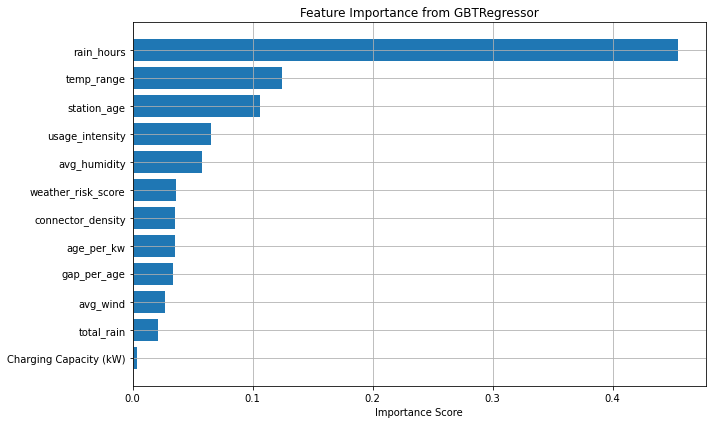

In [0]:
import matplotlib.pyplot as plt

# === 1. Get Feature Importances ===
importances = model.featureImportances.toArray()

# === 2. Pair with Feature Names ===
feature_importance_df = pd.DataFrame({
    "Feature": feature_cols,
    "Importance": importances
}).sort_values(by="Importance", ascending=False)

# === 3. Plot ===
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_df["Feature"], feature_importance_df["Importance"])
plt.gca().invert_yaxis()
plt.xlabel("Importance Score")
plt.title("Feature Importance from GBTRegressor")
plt.grid(True)
plt.tight_layout()
plt.show()


In [0]:
# import os

# # Create the directory if it doesn't exist
# os.makedirs("/dbfs/tmp", exist_ok=True)

# Export the DataFrame
df_pd = df_final.toPandas()
df_pd.to_csv("/dbfs/FileStore/ev_final_export.csv", index=False)


Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/databricks/python/lib/python3.9/site-packages/IPython/core/interactiveshell.py", line 3378, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<command-2590494974432247>", line 8, in <module>
    df_pd.to_csv("/dbfs/FileStore/ev_final_export.csv", index=False)
  File "/databricks/python/lib/python3.9/site-packages/pandas/core/generic.py", line 3551, in to_csv
    return DataFrameRenderer(formatter).to_csv(
  File "/databricks/python/lib/python3.9/site-packages/pandas/io/formats/format.py", line 1180, in to_csv
    csv_formatter.save()
  File "/databricks/python/lib/python3.9/site-packages/pandas/io/formats/csvs.py", line 241, in save
    with get_handle(
  File "/databricks/python/lib/python3.9/site-packages/pandas/io/common.py", line 697, in get_handle
    check_parent_directory(str(handle))
  File "/databricks/python/lib/python3.9/site-packages/pandas/io/common.py", line 571, in check_parent_directory
    raise OSErro

In [0]:
# Check what your username is in DBFS
dbutils.fs.ls("dbfs:/user/")  # Run this to list subdirectories

# Let's say your path is /user/aastha
# output_path = "/dbfs/user/aastha/ev_final_export.csv"

# Save the file
# df_pd.to_csv(output_path, index=False)


Out[12]: [FileInfo(path='dbfs:/user/hive/', name='hive/', size=0, modificationTime=0)]

In [0]:
# Save as CSV to FileStore for download
df_pd = df_final.toPandas()
# df_pd.to_csv("/dbfs/FileStore/ev_charger_enriched.csv", index=False)
df_pd.to_csv("/dbfs/tmp/ev_charger_enriched.csv", index=False)



In [0]:
df_final.display()

Station ID,Latitude,Longitude,Address,Charger Type,Cost (USD/kWh),Availability,Distance to City (km),Usage Stats (avg users/day),Station Operator,Charging Capacity (kW),Connector Types,Installation Year,Renewable Energy Source,Reviews (Rating),Parking Spots,Maintenance Frequency,Station Age (yrs),Days Since Last Maintenance,is_dc_fast,has_multiple_connectors,capacity_level,usage_intensity,parking_spot_density,station_age,age_bucket,available_24_7,uses_renewables,connector_count,connector_density,age_per_kw,gap_per_age,City,temp_range,avg_humidity,rain_hours,total_rain,avg_wind,weather_risk_score,synthetic_stress_score,stress_scaled,days_to_breakdown
EVS00002,37.861857,-122.490299,"8970 San Francisco Ave, San Francisco",DC Fast Charger,0.19,24/7,4.96,83,EVgo,350,"Tesla, Type 2",2010,Yes,3.9,2,Monthly,15,24,1,1,High,0.23714285714285716,41.5,15,Old,1,1,2,41.5,0.04285714285714286,1.6,San Francisco,10.3,55.05,0,0.0,2.76,3.2,4.6436190476190475,0.16195228801478942,324
EVS00003,13.776092,100.412776,"5974 Bangkok Ave, Bangkok",AC Level 2,0.48,6:00-22:00,8.54,24,ChargePoint,50,"Type 2, CCS",2019,No,3.6,9,Annually,6,353,0,1,Low,0.48,2.6666666666666665,6,Mid,0,0,2,12.0,0.12,58.833333333333336,Bangkok,18.21,33.56,9,4.17,2.96,3.8,5.527500000000001,0.23300954824375802,280
EVS00004,43.62825,-79.468935,"6995 Toronto Ave, Toronto",AC Level 1,0.41,9:00-18:00,13.28,70,Greenlots,350,Type 2,2010,Yes,4.2,7,Monthly,15,19,0,0,High,0.2,10.0,15,Old,0,1,1,70.0,0.04285714285714286,1.2666666666666666,Toronto,15.71,68.01,14,8.55,2.33,4.3,6.946999999999999,0.34712647838385635,248
EVS00005,19.119865,72.913368,"5704 Mumbai Ave, Mumbai",AC Level 2,0.11,9:00-18:00,9.76,19,EVgo,350,CCS,2015,Yes,3.7,6,Annually,10,111,0,0,High,0.054285714285714284,3.1666666666666665,10,Mid,0,1,1,19.0,0.02857142857142857,11.1,Mumbai,25.68,71.83,4,5.17,4.46,5.3,7.0208571428571425,0.3530640271064882,247
EVS00006,-23.695008,-46.548187,"1545 São Paulo Ave, São Paulo",AC Level 2,0.22,6:00-22:00,2.02,39,Ionity,350,Tesla,2016,Yes,3.2,9,Quarterly,9,76,0,0,High,0.11142857142857143,4.333333333333333,9,Mid,0,1,1,39.0,0.025714285714285714,8.444444444444445,São Paulo,15.71,68.01,14,8.55,2.33,4.3,6.0223571428571425,0.2727922731474263,270
EVS00007,55.762409,37.65583,"1390 Moscow Ave, Moscow",AC Level 1,0.4,24/7,2.68,89,ChargePoint,350,"Tesla, CCS",2011,Yes,4.0,4,Annually,14,193,0,1,High,0.2542857142857143,22.25,14,Old,1,1,2,44.5,0.04,13.785714285714286,Moscow,15.71,68.01,14,8.55,2.33,4.3,6.818071428571428,0.33676160851504555,264
EVS00008,13.715561,100.561468,"7684 Bangkok Ave, Bangkok",AC Level 2,0.26,24/7,3.63,72,Ionity,350,Tesla,2013,Yes,4.3,9,Annually,12,25,0,0,High,0.2057142857142857,8.0,12,Old,1,1,1,72.0,0.03428571428571429,2.0833333333333335,Bangkok,13.88,71.16,11,13.84,6.06,4.8,6.36942857142857,0.30069415829565443,257
EVS00009,41.807653,-87.755349,"6203 Chicago Ave, Chicago",AC Level 2,0.49,9:00-18:00,6.68,68,Greenlots,350,CCS,2013,No,3.4,1,Monthly,12,11,0,0,High,0.19428571428571428,68.0,12,Old,0,0,1,68.0,0.03428571428571429,0.9166666666666666,Chicago,10.68,82.08,8,6.91,2.9,4.1,5.205571428571428,0.20712895627770228,279
EVS00010,39.968701,116.433865,"4339 Beijing Ave, Beijing",AC Level 2,0.37,9:00-18:00,19.13,82,Tesla,150,"CCS, Tesla",2023,No,4.4,5,Quarterly,2,87,0,1,Medium,0.5466666666666666,16.4,2,Young,0,0,2,41.0,0.013333333333333334,43.5,Beijing,15.06,77.45,9,15.27,3.98,4.9,4.745333333333333,0.17012933770630553,315
EVS00012,55.81937,37.543245,"3932 Moscow Ave, Moscow",AC Level 1,0.17,6:00-22:00,1.88,18,Greenlots,150,"CHAdeMO, CCS",2016,Yes,4.0,5,Annually,9,92,0,1,Medium,0.12,3.6,9,Mid,0,1,2,9.0,0.06,10.222222222222221,Moscow,25.0,15.36,0,0.0,3.72,3.9,6.103666666666666,0.27932893623181954,296
